[Synchrony](#Synchrony)

[Signal modulation](#Information_transmission)

In [1]:
# load libs
import copy
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from scipy import signal

In [2]:
runtime = 5000
cutoff = 3000
fr_cutoff = 500
sampling_rate = 10
dt = 0.01
datalength = runtime*sampling_rate

# 1. Synchrony

## a) INSI computation
quantify the INSI and the stability of it. Plot the time trace of every networks.

In [9]:
# 0.initialize empty arrays to save the summary
diff01 = np.zeros((32)) # the distance between neuron 0 and neuron 1
diff02 = np.zeros((32)) # " " neuron 0 and neuron 2
stddist01 = np.zeros((32)) # measure of stability of distance for each period between neuron 0 and neuron 1
stddist02 = np.zeros((32)) # " " neuron 0 and neuron 2
stddist12 = np.zeros((32)) # " " neuron 1 and neuron 2
period = np.zeros((32)) # period in ms

# iterate over different networks
for t,tau in enumerate(np.arange(0,16,0.5)):
            
            # 1.load data
            datapath = np.reshape(np.loadtxt("datas/signalinjection&firingrate/Take7/Neuronal activities/twobi/run=1_Tau={}.txt".format(tau)),(-1,2))[:datalength]
            centered_datapath = datapath - np.mean(datapath, axis=0) # centering

            # 2.at which time does the spike occur?
            spike0 = signal.find_peaks(centered_datapath[:,0])[0]
            spike1 = signal.find_peaks(centered_datapath[:,1])[0]
            cutoff = min(spike0.shape[0], spike1.shape[0]) # make sure every spike occurs same amount

            # 3.compute INSI and its stability
            dist01 = np.mean((spike0[:cutoff] - spike1[:cutoff])) / sampling_rate
            stddist01[t] = np.std((spike0[:cutoff] - spike1[:cutoff])) / sampling_rate

            # 4.compute the period of neurons
            period[t] = np.mean(np.concatenate((np.ediff1d(spike0), 
                           np.ediff1d(spike1) ))) / sampling_rate

            # 5.take the shorter distance of INSI
            diff01[t] = min(np.abs(dist01), period[t]-np.abs(dist01))

#             # 6.mask unstable values
#             if stddist01[t] > 0.05:
#                 diff01[t] = np.nan
#             if stddist02[t] > 0.05:
#                 diff02[t] = np.nan

np.savez("summary.npz", diff01=diff01,
 stddist01=stddist01, period=period)


/home/minseok/anaconda3/lib/python3.6/site-packages/matplotlib/cbook/__init__.py:424: MatplotlibDeprecationWarning: 
Passing one of 'on', 'true', 'off', 'false' as a boolean is deprecated; use an actual boolean (True/False) instead.
  warn_deprecated("2.2", "Passing one of 'on', 'true', 'off', 'false' as a "


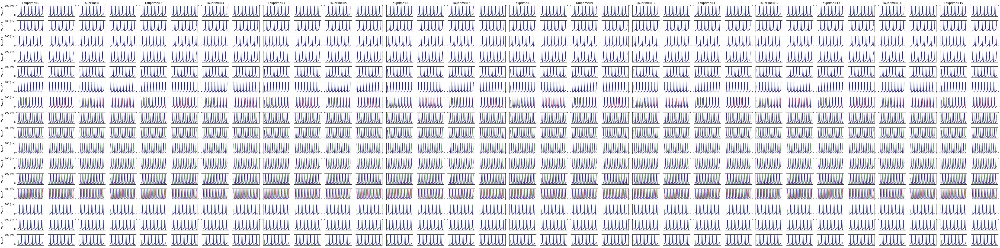

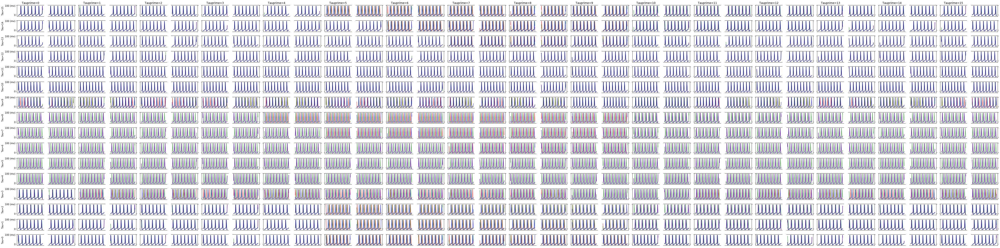

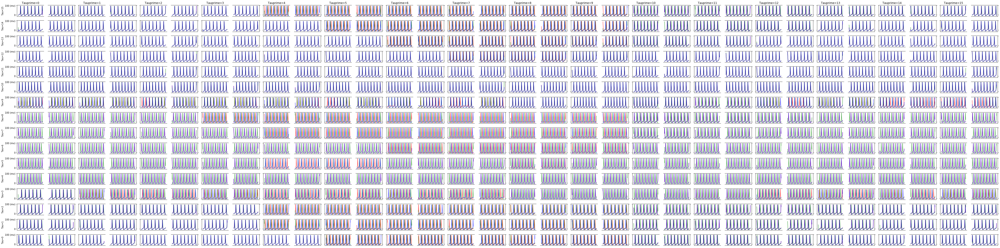

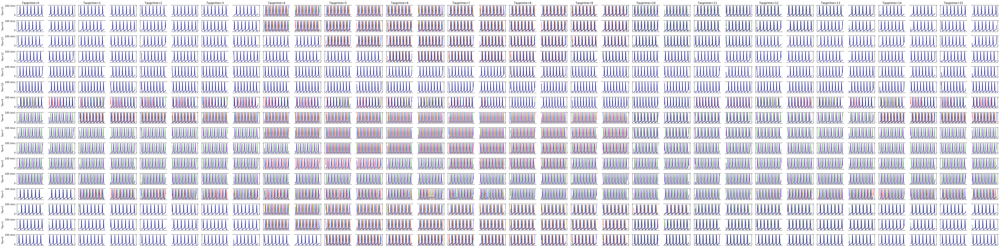

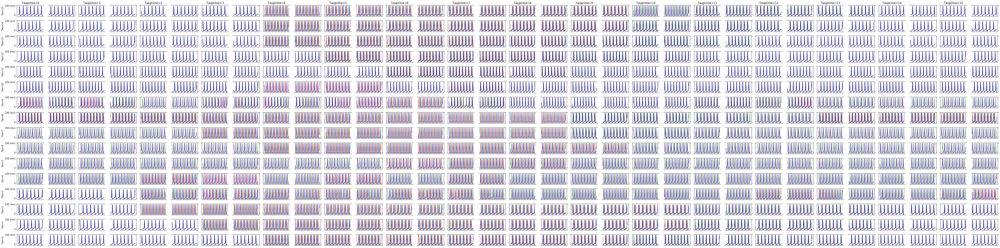

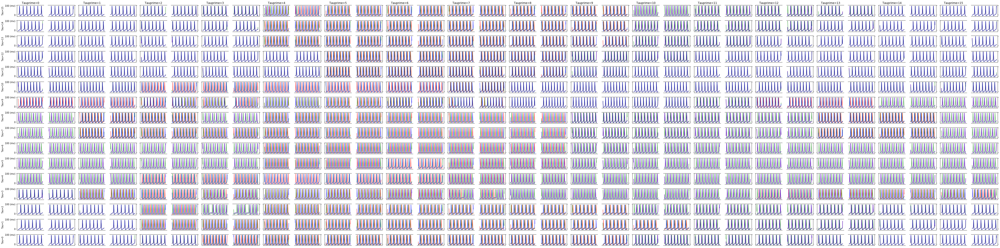

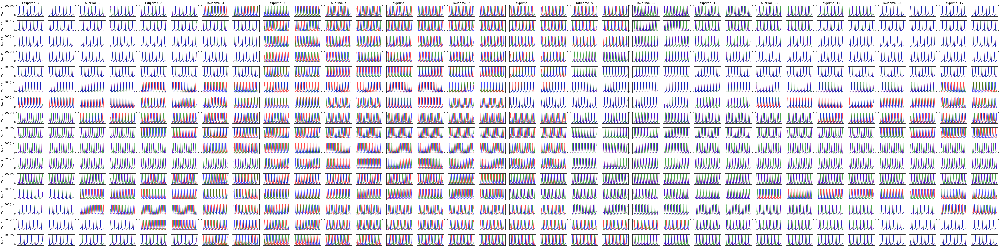

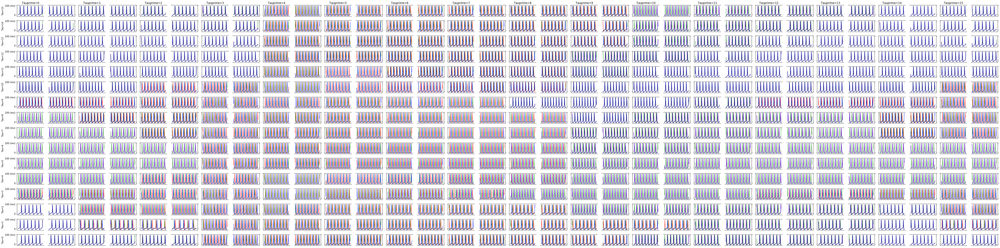

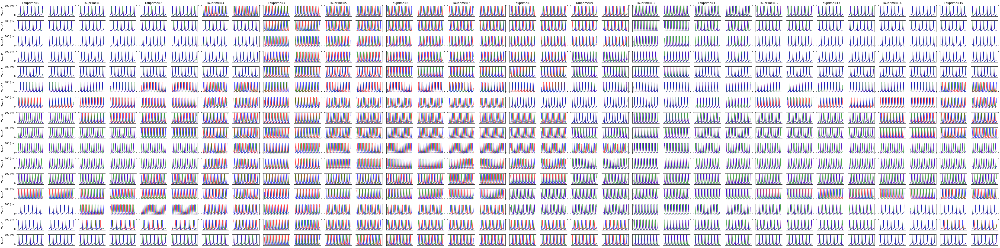

In [2]:
# 0.initialize empty arrays to save the summary
diff01 = np.zeros((9,16,16)) # the distance between neuron 0 and neuron 1
diff02 = np.zeros((9,16,16)) # " " neuron 0 and neuron 2
stddist01 = np.zeros((9,16,16)) # measure of stability of distance for each period between neuron 0 and neuron 1
stddist02 = np.zeros((9,16,16)) # " " neuron 0 and neuron 2
stddist12 = np.zeros((9,16,16)) # " " neuron 1 and neuron 2
period = np.zeros((9,16,16)) # period in ms

# iterate over different networks
for gpi,gprime in enumerate(np.arange(0,18,2)):
    fig,axes = plt.subplots(nrows=16, ncols=32, figsize=(60,15), sharex=False, sharey=True)
    for t,tau in enumerate(range(16)):
        for tp,taup in enumerate(range(16)):
            
            # 1.load data
            datapath = np.reshape(np.loadtxt("datas/signalinjection&firingrate/Take7/Neuronal activities/ \\
             cir_fix/fixinit_run=0_Gprime={}_Tau={}_Tauprime={}.txt".format(gprime,tau,taup)),(-1,3))[:datalength]
            centered_datapath = datapath - np.mean(datapath, axis=0) # centering

            # 2.at which time does the spike occur?
            spike0 = signal.find_peaks(centered_datapath[:,0])[0]
            spike1 = signal.find_peaks(centered_datapath[:,1])[0]
            spike2 = signal.find_peaks(centered_datapath[:,2])[0]
            cutoff = min(spike0.shape[0], spike1.shape[0], spike2.shape[0]) # make sure every spike occurs same amount

            # 3.compute INSI and its stability
            dist01 = np.mean((spike0[:cutoff] - spike1[:cutoff])) / sampling_rate
            dist02 = np.mean((spike0[:cutoff] - spike2[:cutoff])) / sampling_rate
            stddist01[gpi,t,tp] = np.std((spike0[:cutoff] - spike1[:cutoff])) / sampling_rate
            stddist02[gpi,t,tp] = np.std((spike0[:cutoff] - spike1[:cutoff])) / sampling_rate

            # 4.compute the period of neurons
            period[gpi,t,tp] = np.mean(np.concatenate((np.ediff1d(spike0), 
                           np.ediff1d(spike1), np.ediff1d(spike2) ))) / sampling_rate

            # 5.take the shorter distance of INSI
            diff01[gpi,t,tp] = min(np.abs(dist01), period[gpi,t,tp]-np.abs(dist01))
            diff02[gpi,t,tp] = min(np.abs(dist02), period[gpi,t,tp]-np.abs(dist02))

#             # 6.mask unstable values
#             if stddist01[gpi,t,tp] > 0.05:
#                 diff01[gpi,t,tp] = np.nan
#             if stddist02[gpi,t,tp] > 0.05:
#                 diff02[gpi,t,tp] = np.nan

            # 7.plot time traces
            # from 1500 msec to 1600 msec
            axes[15-t, tp*2].plot(datapath[1500*sampling_rate:1600*sampling_rate,0],"r",alpha=0.7)
            axes[15-t, tp*2].plot(datapath[1500*sampling_rate:1600*sampling_rate,1],"g",alpha=0.7)
            axes[15-t, tp*2].plot(datapath[1500*sampling_rate:1600*sampling_rate,2],"b",alpha=0.7)

            axes[15-t, tp*2+1].plot(datapath[2200*sampling_rate:2300*sampling_rate, 0], "r", alpha=0.7)
            axes[15-t, tp*2+1].plot(datapath[2200*sampling_rate:2300*sampling_rate, 1], "g", alpha=0.7)
            axes[15-t, tp*2+1].plot(datapath[2200*sampling_rate:2300*sampling_rate, 2], "b", alpha=0.7)

            axes[15-t, tp*2].set(xticks=[])
            axes[15-t, tp*2+1].set(xticks=[])

            # hide the spines between ax1 and ax2 of the same network
            axes[15-t, tp*2].spines['right'].set_visible(False)
            axes[15-t, tp*2+1].spines["left"].set_visible(False)
            axes[15-t, tp*2].yaxis.tick_left()
            axes[15-t, tp*2].tick_params(labeltop='off')  # don't put tick labels at the top
            axes[15-t, tp*2+1].yaxis.tick_right()

            axes[0, tp*2].set(title="Tauprime={}".format(taup))
            axes[-1, tp*2].set(xticklabels = ["blah", "1500", "1550", "1600"])
            axes[-1, tp*2+1].set(xticklabels = ["blah","2200","2250","2300 (ms)"])
            axes[15-t, 0].set(ylabel="Tau={}".format(tau), yticklabels=["b","0","100 (mv)"])

    fig.tight_layout()
    plt.subplots_adjust(wspace=0.15)
    plt.savefig("Neuronal_activities_Gprime={}.pdf".format(gprime), bbox_inches="tight")

np.savez("summary.npz", diff01=diff01, diff02=diff02, 
 stddist01=stddist01, stddist02=stddist02, stddist12=stddist12, period=period)


# 2. Signal modulation <a id="Information_transmission"></a>

## a) compute the cross-correlation

In [5]:
# 1.load the signal
sig = np.load("Convolved_whitenoise.npy")
sig = sig[int(burnin/dt):int((burnin+runtime)/dt)] - sig[int(burnin/dt):int((burnin+runtime)/dt)].mean()
sig = sig[int(fr_cutoff/dt):runtime]
    
    
# 2.init empty arrays
firingrates = np.zeros((9,16,16,3,47500))
fr0fr2corrs = np.zeros((9,16,16,84999))
sigfr2corrs = np.zeros((9,16,16,84999))
sigfr0corrs = np.zeros((9,16,16,84999))



# 3.compute firing rates and cross-correlations
for gpi,gprime in enumerate(range(0,18,2)):
    for ti,tau in enumerate(range(16)):
        for tpi, taup in enumerate(range(16)):
            # load spike trains
            spiketrain = np.load("datas/spiketrain/withsig/fixinit/cir/ \
                         Gprime={}_Tau={}_Tauprime={}.npy".format(gprime,tau,taup))
            # compute firing rates
            firingrates[gpi,ti,tpi] = firingrate(spiketrain=spiketrain)
            fr2 = firingrates[gpi,ti,tpi,2,fr_cutoff*sampling_rate:]
            fr0 = firingrates[gpi,ti,tpi,0,fr_cutoff*sampling_rate:]
            # compute zero-centered cross-correlations
            fr0fr2corrs[gpi,ti,tpi] = np.correlate(fr0-fr0.mean(),fr2-fr2.mean(),
                                       mode="full") /(fr0.std()*fr2.std()*fr2.shape[0])
            sigfr2corrs[gpi,ti,tpi] = np.correlate(sig-sig.mean(),fr2-fr2.mean(),
                                       mode="full") /(sig.std()*fr2.std()*fr2.shape[0])
            sigfr0corrs[gpi,ti,tpi] = np.correlate(sig-sig.mean(),fr0-fr0.mean(),
                                       mode="full") /(sig.std()*fr0.std()*fr2.shape[0])

# 4. save data            
np.save("firingrates.npy",firingrates)
np.save("crosscorrs_centered_fr0fr2corrs.npy",fr0fr2corrs)
np.save("crosscorrs_centered_sigfr2corrs.npy",sigfr2corrs)
np.save("crosscorrs_centered_sigfr0corrs.npy",sigfr0corrs)

## b) create summary statistics

In [3]:
# load datas
motif="cir"
firingrates = np.load("datas/BAdata/info/firingrate/"+motif+"/firingrates.npy")
fr0fr2corrs = np.load("datas/BAdata/info/firingrate/"+motif+"/fr0fr2corrs.npy")
sigfr2corrs = np.load("datas/BAdata/info/firingrate/"+motif+"/sigfr2corrs.npy")
sigfr0corrs = np.load("datas/BAdata/info/firingrate/"+motif+"/sigfr0corrs.npy")

In [3]:
maxfr0fr2corrs = np.zeros(16)
maxsigfr2corrs = np.zeros(16)
maxsigfr0corrs = np.zeros(16)
maxposfr0fr2corrs = np.zeros(16)
maxpossigfr2corrs = np.zeros(16)
maxpossigfr0corrs = np.zeros(16)

for t,tau in enumerate(np.arange(0,16,1)):
    maxfr0fr2corrs[tau] = np.max(fr0fr2corrs[tau])
    maxsigfr2corrs[tau] = np.max(sigfr2corrs[tau])
    maxsigfr0corrs[tau] = np.max(sigfr0corrs[tau])

    maxposfr0fr2corrs[tau] = (np.argmax(fr0fr2corrs[tau]) - fr0fr2corrs[tau].shape[-1]//2)/10
    maxpossigfr2corrs[tau] = (np.argmax(sigfr2corrs[tau]) - sigfr2corrs[tau].shape[-1]//2)/10
    maxpossigfr0corrs[tau] = (np.argmax(sigfr0corrs[tau]) - sigfr0corrs[tau].shape[-1]//2)/10
    
np.savez("sum.npz", maxfr0fr2corrs=maxfr0fr2corrs, maxsigfr2corrs=maxsigfr2corrs,
         maxsigfr0corrs=maxsigfr0corrs, maxposfr0fr2corrs=maxposfr0fr2corrs,
         maxpossigfr0corrs=maxpossigfr0corrs, maxpossigfr2corrs=maxpossigfr2corrs)

In [4]:
# 0.init empty arrays
maxfr0fr2corrs = np.zeros((9,16,16))
maxsigfr2corrs = np.zeros((9,16,16))
maxsigfr0corrs = np.zeros((9,16,16))
maxposfr0fr2corrs = np.zeros((9,16,16))
maxpossigfr2corrs = np.zeros((9,16,16))
maxpossigfr0corrs = np.zeros((9,16,16))
len_timeseries = fr0fr2corrs.shape[-1]

# 1.identify max or argmax
for gpi,gprime in enumerate(np.arange(0,18,2)):
    for t,tau in enumerate(np.arange(0,16,1)):
        for tp,taup in enumerate(np.arange(0,16,1)):
            # maximum of cross-corelation function
            maxfr0fr2corrs[gpi,tau,taup] = np.max(fr0fr2corrs[gpi,tau,taup])
            maxsigfr2corrs[gpi,tau,taup] = np.max(sigfr2corrs[gpi,tau,taup])
            maxsigfr0corrs[gpi,tau,taup] = np.max(sigfr0corrs[gpi,tau,taup])
            # argmax of cross-correlation function, should match the delay
            maxposfr0fr2corrs[gpi,tau,taup] = (np.argmax(fr0fr2corrs[gpi,tau,taup]) - 
                                               len_timeseries//2)/sampling_rate
            maxpossigfr2corrs[gpi,tau,taup] = (np.argmax(sigfr2corrs[gpi,tau,taup]) - 
                                               len_timeseries//2)/sampling_rate
            maxpossigfr0corrs[gpi,tau,taup] = (np.argmax(sigfr0corrs[gpi,tau,taup]) - 
                                               len_timeseries//2)/sampling_rate

# 2.save data
np.savez("sum.npz", maxfr0fr2corrs=maxfr0fr2corrs, maxsigfr2corrs=maxsigfr2corrs,
         maxsigfr0corrs=maxsigfr0corrs, maxposfr0fr2corrs=maxposfr0fr2corrs,
         maxpossigfr0corrs=maxpossigfr0corrs, maxpossigfr2corrs=maxpossigfr2corrs)

# 3. phase response curve

In [3]:
from scipy import integrate
accindex=75
PRCfirst=np.zeros((2,34,100,3))
maxvalues=np.zeros((2,34))
minvalues=np.zeros((2,34))
# third_maxvalues=np.zeros(2,34)
# third_minvalues=np.zeros(2,34)
# maxpos=np.zeros(2,34)
# minpos=np.zeros(2,34)
rellen=np.zeros((2,34))
period=np.zeros((2,34))
AUC=np.zeros((3,2,34))
charge_total=np.zeros((2,34))

for t,tau in enumerate(np.arange(0,17,0.5)):
    for networkindex in [0,1]:
        if networkindex == 0:
            result = np.load("datas/PRC/datas/side_pert/Tau={}.npy".format(tau))
        else:
            result = np.load("datas/PRC/datas/middle_pert/Tau={}.npy".format(tau))
    #PRC and it's extrema
        PRCfirst[networkindex,t] = (result[2] - (result[1][:,:,1]-result[1][:,:,0])) /result[2]  
    #         third_maxvalues[networkindex,t]=max(PRCfirst[t,:,2])
    #         third_minvalues[networkindex,t]=min(PRCfirst[t,:,2])
        maxvalues[networkindex,t] = max(PRCfirst[networkindex,t,:,0])
        minvalues[networkindex,t] = min(PRCfirst[networkindex,t,:,0])
    #         maxpos[networkindex,t] = np.argmax(PRCfirst[t,:,0])
    #         minpos[networkindex,t] = np.argmin(PRCfirst[t,:,0])

        #distance between diff spikes
    #     ffs = np.where(result[0][accindex,0,:2,:6000])[0][0]
    #     sfs = min(np.where(result[0][accindex,1,:2,:6000])[0][np.where(result[0][accindex,1,:2,:6000])[0] > ffs])
    #     rellen[networkindex,t] = (sfs-ffs)
        try:
            sfs_delayed = np.where(result[0][accindex,1,:6000])[0][0]+tau*100
            fbs = max(np.where(result[0][accindex,0,:6000])[0][np.where(result[0][accindex,0,:6000])[0] < sfs_delayed])
            rellen[networkindex,t] = (sfs_delayed-fbs)/result[2]
        except ValueError:
            sfs_delayed = np.where(result[0][accindex,1,:6000])[0][1]+tau*100
            fbs = max(np.where(result[0][accindex,0,:6000])[0][np.where(result[0][accindex,0,:6000])[0] < sfs_delayed])
            rellen[networkindex,t] = (sfs_delayed-fbs)/result[2]

        AUC[:,networkindex,t] = integrate.simps(np.abs(PRCfirst[networkindex,t]),axis=0)
        period[networkindex,t] = result[2]

        #total charge of alpha_function for one period
        c = np.where(result[0][accindex,1])[0][0] +int(tau*100)
        b = min(np.where(result[0][accindex,0])[0][np.where(result[0][accindex,0])[0] >c])
        a = b-int(result[2])
        tauplus=0.1
        tauminus = 4
        x=np.linspace(0,result[2]*0.01,int(result[2])+1)
        alpha_func = (np.exp(-x/tauminus)-np.exp(-x/tauplus))/(tauminus-tauplus)
        charge_total[networkindex,t] = integrate.simps(alpha_func[c-a:])+integrate.simps(alpha_func[:b-c])